In [1]:
import numpy as np
import pandas as pd
import os
from shutil import copyfile
import pickle
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import colorlover as cl


import neuro_morpho_toolbox as nmt
%matplotlib inline
import pickle
pickle_in = open("/home/penglab/FeaCal/all_ns.pickle","rb")
[ns] = pickle.load(pickle_in)


/home/penglab/anaconda3/lib/python3.7/site-packages/neuro_morpho_toolbox-0.1-py3.7.egg/neuro_morpho_toolbox/
Loading CCF Atlas data...
Loading time: 0.80
Loading CCF brain structure data...
Loading time: 0.00


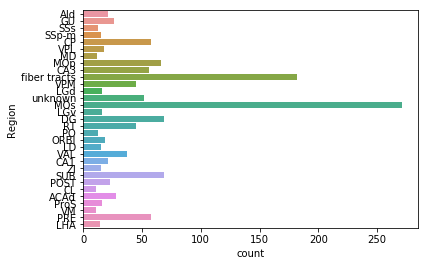

In [2]:
sf = ns.features['soma_features'].region
ct = sf["Region"].value_counts().sort_values(ascending=False)
_ = sns.countplot(y="Region", 
                  data=sf.loc[sf.Region.isin(ct.index[ct>10])],
                 )

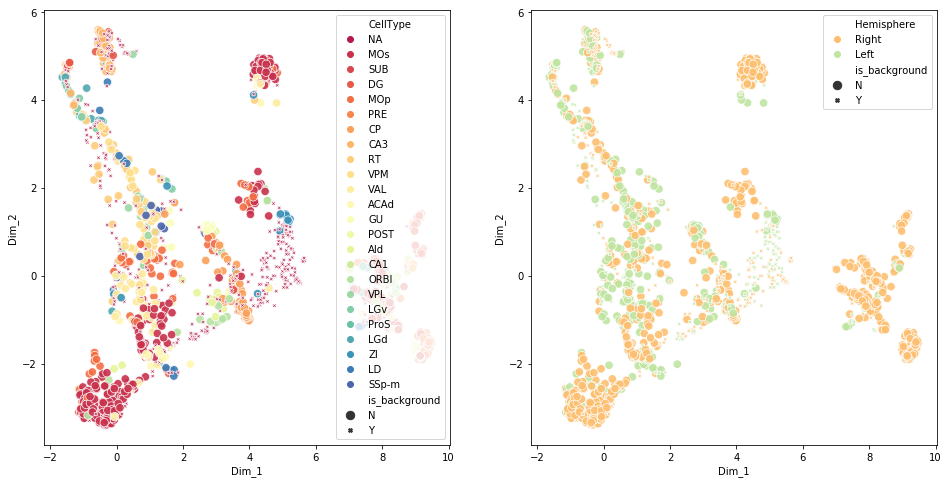

In [3]:
_ = ns.ReduceDimUMAP(feature_set="projection_features", n_neighbors=100)
_ = ns.FeatureScatter(["CellType", "Hemisphere"], map="UMAP")

### Generate the dataframe in pickCLUSTERpara(method)

In [4]:
import pickle
pickle_in = open("/home/penglab/NMTcode/selectedDF.pickle","rb")
[selectedDF] = pickle.load(pickle_in)


In [5]:
from sklearn import metrics
from random import randrange
def pickCLUSTERpara(method,selected_list):
    if len(selected_list) >0:
        print('Will calculate ARI for '+ str(len(selected_list) ) + ' neurons')
    result_DF = pd.DataFrame()
    method_list = ['kmeans','snn','hdbscan','hierarchy','dbscan']
    assert method in method_list, "Should be one of "+str(method_list)
    colname = ['ARI','NumCluster','parameter']
    if method.lower() == 'hierarchy':
        #%% Store the result of Hierarchy
        result_hier = pd.DataFrame(columns = colname)
        L_method_list=['single', 'complete','average','weighted','centroid','median','ward']
        L_metric_list=['braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation', 'cosine',
                       'dice', 'euclidean', 'hamming', 'jaccard', 'kulsinski', 
                       'mahalanobis', 'matching','minkowski','rogerstanimoto', 'russellrao',
                       'seuclidean', 'sokalmichener', 'sokalsneath', 'sqeuclidean']

        criterionH_list=['inconsistent','distance','maxclust','monocrit','maxclust_monocrit']

        hier_dict={'L_method':'single', 'L_metric':'euclidean','criterionH':'inconsistent', 'depth':2,'R':None,
                   't':0.9,'optimal_ordering':False,'colR':3}
        for L_methodidx in L_method_list:
            hier_dict.update(L_method = L_methodidx)
            for L_metricidx in L_metric_list:
                hier_dict.update(L_metric = L_metricidx )
                # so far the parameter to generate the linkage array is set
                if L_methodidx == 'centroid' or L_methodidx == 'median' or L_methodidx == 'ward':
                    if L_metricidx != 'euclidean':
                        continue         
                for criterionidx in criterionH_list:
                    hier_dict.update(criterionH = criterionidx )   
                    if criterionidx == 'inconsistent' or criterionidx == 'distance':
                        for t_iter in  np.arange(0,1.6,0.05)  : 
                            hier_dict.update(t = t_iter) 
                            if criterionidx == 'inconsistent':
                                for depth_iter in range(2,16):
                                    hier_dict.update(depth = depth_iter) 
                                    _ = ns. get_clusters(method='Hierarchy',karg_dict=hier_dict)
                                    if len(selected_list)==0:
                                        selected_list = ns.metadata.index.tolist()
                                    tempARI = metrics.adjusted_rand_score(ns.metadata.loc[selected_list,'CellType'],
                                                                          ns.metadata.loc[selected_list,'Cluster'])
                                    tempDF = pd.DataFrame([tempARI, 
                                                           len(list(ns.metadata.groupby('Cluster'))),
                                                           str(hier_dict)]).T.copy()
                                    tempDF.columns=colname
                                    print(str(hier_dict))
                                    result_hier = result_hier.append(tempDF) 
                            elif criterionidx == 'distance':
                                _ = ns. get_clusters(method='Hierarchy',karg_dict=hier_dict)
                                tempARI = metrics.adjusted_rand_score(ns.metadata.loc[selected_list,'CellType'],
                                                                          ns.metadata.loc[selected_list,'Cluster'])
                                tempDF = pd.DataFrame([tempARI, 
                                                       len(list(ns.metadata.groupby('Cluster'))),
                                                       str(hier_dict)]).T.copy()
                                tempDF.columns=colname
                                print(str(hier_dict))
                                result_hier = result_hier.append(tempDF) 
                    if criterionidx == 'maxclust' or criterionidx == 'maxclust_monocrit':
                        for t_iter in  range(20,51): 
                            hier_dict.update(t = t_iter) 
                            _ = ns. get_clusters(method='Hierarchy',karg_dict=hier_dict)
                            tempARI = metrics.adjusted_rand_score(ns.metadata.loc[selected_list,'CellType'],
                                                                          ns.metadata.loc[selected_list,'Cluster'])
                            tempDF = pd.DataFrame([tempARI, 
                                                   len(list(ns.metadata.groupby('Cluster'))),
                                                   str(hier_dict)]).T.copy()
                            tempDF.columns=colname
                            print(str(hier_dict))
                            result_hier = result_hier.append(tempDF) 
                               
        idx_hier = ['Hier'+str(x) for x in range(result_hier.shape[0])]    
        result_hier['idx'] = idx_hier
        result_hier.set_index('idx',inplace=True)  
        result_DF = result_hier.copy()
        
    if method.lower() == 'kmeans':
        result_kmeans = pd.DataFrame(columns = colname)
        init_list=['k-means++','random']
        algorithm_list = ['auto','full','elkan']
        precompute_distances_list = ['auto', True, False]
        n_init_list=['braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation', 'cosine',
                       'dice', 'euclidean', 'hamming', 'jaccard', 'kulsinski', 
                       'mahalanobis', 'matching','minkowski','rogerstanimoto', 'russellrao',
                       'seuclidean', 'sokalmichener', 'sokalsneath', 'sqeuclidean']
        criterionH_list='inconsistent','distance','maxclust','monocrit','maxclust_monocrit'
        kmeans_dict={'n_clusters':20, 'init':'k-means++', 'n_init':10, 'max_iter':300, 'tol':0.0001,
                     'precompute_distances':'auto', 'verbose':0, 'random_state':None,'copy_x': True,
                     'n_jobs':12, 'algorithm':'auto'}
        for init_idx in init_list:
            kmeans_dict.update(init = init_idx)
            for algorithm_idx in algorithm_list:
                kmeans_dict.update(algorithm = algorithm_idx )
                for precompute_distances_idx in precompute_distances_list:
                    kmeans_dict.update(precompute_distances = precompute_distances_idx )
                    for n_clustersidx in range(3,45):
                        kmeans_dict.update(n_clusters = n_clustersidx)     
                        for n_initidx in range(7,15):
                            kmeans_dict.update(n_init = n_initidx) 
                            for tol_idx in np.exp(-np.arange(2,4,0.2)):
                                kmeans_dict.update(tol = tol_idx) 
                                print(kmeans_dict)
                                _ = ns. get_clusters(method='Kmeans',karg_dict=kmeans_dict)
                                tempARI = metrics.adjusted_rand_score(ns.metadata.loc[selected_list,'CellType'],
                                                                          ns.metadata.loc[selected_list,'Cluster'])
                                tempDF = pd.DataFrame([tempARI, 
                                                       len(list(ns.metadata.groupby('Cluster'))),
                                                       str(kmeans_dict)]).T.copy()
                                tempDF.columns=colname
                                print(str(kmeans_dict))
                                result_kmeans = result_kmeans.append(tempDF)         
        idx_kmeans = ['KMeans'+str(x) for x in range(result_kmeans.shape[0])]    
        result_kmeans['idx'] = idx_kmeans
        result_kmeans.set_index('idx',inplace=True)       
        result_DF = result_kmeans.copy()
        
    if method.lower() == 'dbscan':
        result_dbscan = pd.DataFrame(columns = colname)
        algorithm_list = ['auto','ball_tree', 'kd_tree', 'brute']# 
         #
        metriclist = [ 'braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation','euclidean', 'cosine',
                      'dice','hamming', 'jaccard', 'kulsinski', 'matching','minkowski','rogerstanimoto','russellrao','sokalmichener', 'sokalsneath']
        dbscan_dict={'eps':20, 'min_samples':5, 'metric':'euclidean','metric_params':None, 'algorithm':'auto', 
                     'leaf_size':30, 'p':None,'n_jobs':12}
        for algorithm_idx in algorithm_list:
            dbscan_dict.update(algorithm = algorithm_idx )
            for metric_iter in metriclist:
                dbscan_dict.update(metric= metric_iter)
                if algorithm_idx == 'ball_tree' and metric_iter in ['correlation','cosine','sqeuclidean']:
                    continue
                if algorithm_idx == 'kd_tree' and metric_iter not in ['chebyshev', 'cityblock', 'euclidean',
                                                                                   'infinity', 'l1', 'l2', 'manhattan',
                                                                                  'minkowski', 'p']:
                    continue
                if algorithm_idx == 'brute' and metric_iter in ['haversine','wminkowski', 'mahalanobis','infinity']:
                    continue
                if metric_iter in ['wminkowski', 'minkowski']:
                    p_iter =randrange(1,10)
                    dbscan_dict.update(p = p_iter)
                    while metric_iter == 'minkowski' and p_iter == 1:
                        p_iter =randrange(2,10)
                        dbscan_dict.update(p = p_iter)
                for epsidx in np.exp(-np.arange(0,4,0.5)):
                    dbscan_dict.update(eps = epsidx)
                    for min_samples_iter in range(5,10):
                        dbscan_dict.update(min_samples = min_samples_iter)
                        for leaf_size_iter in range(25,35):
                            dbscan_dict.update(leaf_size = leaf_size_iter)
                            _ = ns. get_clusters(method='DBSCAN',karg_dict=dbscan_dict)
                            tempARI = metrics.adjusted_rand_score(ns.metadata.loc[selected_list,'CellType'],
                                                                          ns.metadata.loc[selected_list,'Cluster'])
                            tempDF = pd.DataFrame([tempARI, len(list(ns.metadata.groupby('Cluster'))),str(dbscan_dict)]).T.copy()
                            tempDF.columns=colname
                            print(str(dbscan_dict))
                            result_dbscan = result_dbscan.append(tempDF)        
        idx_dbscan = ['DBSCAN'+str(x) for x in range(result_dbscan.shape[0])]    
        result_dbscan['idx'] = idx_dbscan
        result_dbscan.set_index('idx',inplace=True)     
        result_DF = result_dbscan.copy()
        
    if method.lower() == 'hdbscan':
        result_hdbscan = pd.DataFrame(columns = colname)
        #
        metric_list = [ 'euclidean','minkowski', 'l2', 'l1', 'manhattan', 'cityblock', 'braycurtis', 'canberra',
                       'chebyshev','correlation','dice', 'hamming', 'jaccard','kulsinski', 'matching', 
                       'rogerstanimoto', 'russellrao','sokalmichener', 'sokalsneath', 'sqeuclidean', 'yule']
        
    
        algorithm_list = ['best', 'generic','prims_kdtree','boruvka_kdtree']#, 
        cluster_selection_method_list = ['leaf','eom']
        hdbscan_dict={'min_cluster_size':5, 'metric':'euclidean','alpha':1.0, 'min_samples':1,
                      'p':2,'algorithm':'best', 'leaf_size':40, 'approx_min_span_tree':True,
                      'gen_min_span_tree':False,'core_dist_n_jobs':4,'cluster_selection_method':'eom',
                      'allow_single_cluster': False,'prediction_data':False,
                      'match_reference_implementation':False}

        for algorithm_idx in algorithm_list:
            hdbscan_dict.update(algorithm = algorithm_idx)
            for metric_idx in metric_list:
                if algorithm_idx=='boruvka_kdtree' and metric_idx in['braycurtis','canberra','dice','hamming',
                                                                     'jaccard','kulsinski','matching','rogerstanimoto',
                                                                     'russellrao','sokalmichener', 'sokalsneath']:
                    continue
                hdbscan_dict.update(metric = metric_idx)
                for cluster_selection_method_idx in cluster_selection_method_list:
                    hdbscan_dict.update(cluster_selection_method = cluster_selection_method_idx )
                    for alpha_idx in np.arange(0.8,1.5,0.1):
                        hdbscan_dict.update(alpha = alpha_idx)
                        for min_samples_iter in range(1,10):
                            hdbscan_dict.update(min_samples = min_samples_iter)
                            #print(hdbscan_dict)
                            _ = ns. get_clusters(method='HDBSCAN',karg_dict=hdbscan_dict)
                            tempARI = metrics.adjusted_rand_score(ns.metadata.loc[selected_list,'CellType'],
                                                                          ns.metadata.loc[selected_list,'Cluster'])
                            tempDF = pd.DataFrame([tempARI, len(list(ns.metadata.groupby('Cluster'))),str(hdbscan_dict)]).T.copy()
                            tempDF.columns = colname
                            print(str(hdbscan_dict))
                            result_hdbscan = result_hdbscan.append(tempDF)     

        idx_hdbscan = ['HDBSCAN'+str(x) for x in range(result_hdbscan.shape[0])]    
        result_hdbscan['idx'] = idx_hdbscan
        result_hdbscan.set_index('idx',inplace=True)       
        result_DF = result_hdbscan.copy()
    if method.lower() == 'snn':
        metric_list = ['sqeuclidean','euclidean','minkowski', 'l2', 'l1', 'manhattan', 'cityblock', 'braycurtis',
                       'canberra','chebyshev']
        snn_dict = {'knn':5, 'metric':'minkowski','method':'FastGreedy'}
        result_snn= pd.DataFrame(columns = colname)
        for knn_iter in range(3,30):
            snn_dict.update(knn =knn_iter)
            for metric_idx in metric_list:
                snn_dict.update(metric = metric_idx)
                _ = ns. get_clusters(method='SNN_community',karg_dict=snn_dict)
                tempARI = metrics.adjusted_rand_score(ns.metadata.loc[selected_list,'CellType'],
                                                                          ns.metadata.loc[selected_list,'Cluster'])
                tempDF = pd.DataFrame([tempARI, len(list(ns.metadata.groupby('Cluster'))),str(snn_dict)]).T.copy()
                tempDF.columns=colname
                print(str(snn_dict))
                result_snn = result_snn.append(tempDF)
        idx_snn = ['SNN'+str(x) for x in range(result_snn.shape[0])]    
        result_snn['idx'] = idx_snn
        result_snn.set_index('idx',inplace=True)  
        result_DF = result_snn.copy()
    return result_DF.copy()
    

In [6]:
se_list = selectedDF.index.tolist()

In [8]:
kmeans_resultDF = pickCLUSTERpara('kmeans',se_list)
kmeans_resultDF.to_excel('/home/penglab/NMTcode/kmeans_resultDF.xlsx')

Will calculate ARI for 1006 neurons
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300,

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110803158362

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.13533

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.033

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.06081

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0907179

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'to

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300,

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300,

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0497870

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13533

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300,

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'to

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300,

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300,

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300,

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, '

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, '

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 3

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 30

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 3

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300,

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300,

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter':

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 3

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 30

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300,

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 3

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300,

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 30

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300,

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter':

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 30

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300,

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter':

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter':

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 3

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300,

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, '

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter':

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300,

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 3

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 30

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, '

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300,

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300,

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter'

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, '

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter':

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 3

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, '

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300,

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300,

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 3

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300,

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter':

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300,

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300,

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.06081

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0907179

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300,

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300,

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'to

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'pre

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precomp

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'p

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precom

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precomp

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precomp

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precomp

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precomp

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'p

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'pre

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'p

{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0407622039783661

{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604,

{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, '

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'p

{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333732699603

{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, '

{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'pr

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783661

{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'p

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039783661

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783661

{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397

{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'pre

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'p

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'p

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'pre

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617,

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'p

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, '

{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, '

{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.13533528323661

{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.13533528323661

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333732699

Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter':

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.13533528323661

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556

{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556

{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252

{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836

{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836

{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'p

{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'pre

{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'prec

{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'pr

{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'p

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'pr

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407622039783661

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604,

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 

{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604,

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699603

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783661

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367

Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter'

{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'p

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617,

{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, '

{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'pr

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'p

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'p

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'pr

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'pr

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'pre

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247,

{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623338

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.13533528323661

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247,

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608100626252179

{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608100626252179

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561

{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561

{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039

{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039

{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0333732

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333732

{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333732

{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0333732

{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333732

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, '

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'pre

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'p

{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626252179

{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617,

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'p

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'p

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'pre

{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247,

{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623338

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.13533528323661

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247,

{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608100626252179

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608100626252179

{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333732699603260

{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247,

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803158362

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

In [ ]:
aaaaaaaaaaaaaaaaaaaa

In [ ]:
import pandas as pd
hier_resultDF = pd.read_excel('/home/penglab/NMTcode/hier_resultDF.xlsx', index_col=0)
kmeans_resultDF = pd.read_excel('/home/penglab/NMTcode/kmeans_resultDF.xlsx', index_col=0)
dbscan_resultDF = pd.read_excel('/home/penglab/NMTcode/dbscan_resultDF.xlsx', index_col=0)
hdbscan_resultDF = pd.read_excel('/home/penglab/NMTcode/hdbscan_resultDF.xlsx', index_col=0)
snn_resultDF = pd.read_excel('/home/penglab/NMTcode/snn_resultDF.xlsx', index_col=0)

### weighted ARI

In [ ]:
from scipy.spatial import distance
import ast
import time
def findBESTpara(inputDF,clusterRange,scaledDF,flipF = True):
    start = time.time()
    inputDF.drop_duplicates(subset=None, keep='first', inplace=True)
    [minR,maxR] = clusterRange
    inputDF = inputDF[inputDF['NumCluster'] >= minR] 
    inputDF = inputDF[inputDF['NumCluster'] <= maxR] 
    i_p = 0
    selectedDF = scaledDF[scaledDF['SqEuclidean'] != str([0])].copy()
    selectedIDX
        i_p = i_p+1
        tempCoor = np.array([[scaledDF.loc[idx,'x'],scaledDF.loc[idx,'y'],scaledDF.loc[idx,'z']]])
        tempID = nmt.annotation.array[int(scaledDF.loc[idx,'x']),int(scaledDF.loc[idx,'y']),int(scaledDF.loc[idx,'z'])]
        coords = []
        if tempID == 0:
            continue
        Mask_temp = (nmt.annotation.array == tempID).copy()
        Mask_temp = np.multiply(Mask_temp,contour_M)
        co_1_temp,co_2_temp,co_3_temp = np.where( Mask_temp >0)
        for icoor in range(len(co_1_temp)):
            coords.append([co_1_temp[icoor], co_2_temp[icoor], co_3_temp[icoor]])
        zs = np.sort(distance.cdist(tempCoor,coords, 'sqeuclidean'))[0,0:min(10,distance.cdist(tempCoor,coords, 'sqeuclidean').shape[1])]
        scaledDF.loc[idx,'SqEuclidean'] = str(zs.tolist())
        
        print('Load progress: %.5f'% (i_p/scaledDF.shape[0]))
    end = time.time()
    print("Total loading time: %.2f" % (end-start))
    return scaledDF.copy()

In [ ]:
testR = findBESTpara(hier_resultDF,[15,45],ns.features['soma_features'].raw_data,flipF = True)

In [ ]:
for iter_str in hier_resultDF.loc['Hier0','ClusterINFO'].split("\n"):
    if 'fiber tracts' in iter_str:
        iter_str = iter_str.replace("fiber tracts","fiber_tracts")
    iter_str = iter_str.split()
    print(iter_str )
    print('******')

In [ ]:
hier_resultDF.loc['Hier0','ClusterINFO']

In [ ]:
aa = 'a a g d s fiber tracts'
aa=aa.replace("fiber tracts", "fiber_tracts")
aa

In [ ]:
np.sum(M_show!=0)

In [ ]:
regionN, count = np.unique(M_show, return_counts=True)
regionN

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.spatial import ConvexHull


M_show = np.multiply(nmt.annotation.array.copy(),contour_M_6)

co_1,co_2,co_3 = np.where(M_show ==1016)
#co_1 = co_1[co_3<=nmt.annotation.size['z']//2]
#co_2 = co_2[co_3<=nmt.annotation.size['z']//2]
#co_3 = co_3[co_3<=nmt.annotation.size['z']//2]
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")

# Plot defining corner points
ax.plot(co_1, co_2,co_3, "b.")

# 12 = 2 * 6 faces are the simplices (2 simplices per square face)


# Make axis label
for i in ["x", "y", "z"]:
    eval("ax.set_{:s}label('{:s}')".format(i, i))

plt.show()


In [ ]:
nmt.bs.id_to_name(507)

In [ ]:
testR = testR.fillna('unknown')
testR.to_excel('/home/penglab/NMTcode/testR.xlsx')

In [ ]:
nmt.annotation.size

In [ ]:
nmt.annotation.space

In [ ]:
nmt.annotation.array.shape

In [ ]:
528* 320* 456